# Temperature Forecast Project using ML

## Project Description
This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model
operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017.The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.


## Attribute Information:
For more information, read [Cho et al, 2020].
1. station - used weather station number: 1 to 25
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
19. lat - Latitude (Â°): 37.456 to 37.645
20. lon - Longitude (Â°): 126.826 to 127.135
21. DEM - Elevation (m): 12.4 to 212.3
22. Slope - Slope (Â°): 0.1 to 5.2
23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9
25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

You have to build separate models that can predict the minimum temperature for the next day and the maximum temperature for the next day based on the details provided in the dataset.


Dataset Link-

https://github.com/dsrscientist/Dataset2/blob/main/temperature.csv

In [ ]:
#header files
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline
import warnings 
warnings.filterwarnings('ignore')

In [106]:
#read file
df=pd.read_csv('temperature.csv')

# Statistical analysis

In [3]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [4]:
df.shape

(7752, 25)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [8]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
station,7750.0,13.000000,7.211568,1.000000,7.000000,13.000000,19.000000,25.000000
Present_Tmax,7682.0,29.768211,2.969999,20.000000,27.800000,29.900000,32.000000,37.600000
Present_Tmin,7682.0,23.225059,2.413961,11.300000,21.700000,23.400000,24.900000,29.900000
LDAPS_RHmin,7677.0,56.759372,14.668111,19.794666,45.963543,55.039024,67.190056,98.524734
LDAPS_RHmax,7677.0,88.374804,7.192004,58.936283,84.222862,89.793480,93.743629,100.000153
LDAPS_Tmax_lapse,7677.0,29.613447,2.947191,17.624954,27.673499,29.703426,31.710450,38.542255
LDAPS_Tmin_lapse,7677.0,23.512589,2.345347,14.272646,22.089739,23.760199,25.152909,29.619342
LDAPS_WS,7677.0,7.097875,2.183836,2.882580,5.678705,6.547470,8.032276,21.857621
LDAPS_LH,7677.0,62.505019,33.730589,-13.603212,37.266753,56.865482,84.223616,213.414006
LDAPS_CC1,7677.0,0.368774,0.262458,0.000000,0.146654,0.315697,0.575489,0.967277


#### Comment :
- All variable are Numerical in nature.
- Next_Tmax and Next_Tmin are Target Variable.
- This dataset contain 7752 Rows and 25 Columns.

# Data cleaning

In [3]:
df.isnull().sum() 

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

<AxesSubplot:>

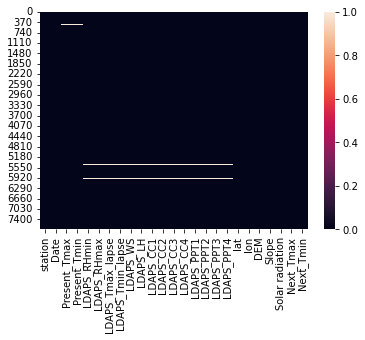

In [3]:
sns.heatmap(df.isnull())

In [4]:
#Finding what percentage of data is missing from the dataset
missing_values = df.isnull().sum().sort_values(ascending = False)
percentage_missing_values =(missing_values/len(df))*100
print(percentage_missing_values, '%Missing data')

LDAPS_CC3           0.967492
LDAPS_PPT4          0.967492
LDAPS_PPT2          0.967492
LDAPS_PPT1          0.967492
LDAPS_CC4           0.967492
LDAPS_CC2           0.967492
LDAPS_CC1           0.967492
LDAPS_LH            0.967492
LDAPS_WS            0.967492
LDAPS_Tmin_lapse    0.967492
LDAPS_Tmax_lapse    0.967492
LDAPS_RHmax         0.967492
LDAPS_RHmin         0.967492
LDAPS_PPT3          0.967492
Present_Tmin        0.902993
Present_Tmax        0.902993
Next_Tmax           0.348297
Next_Tmin           0.348297
Date                0.025800
station             0.025800
lat                 0.000000
lon                 0.000000
DEM                 0.000000
Slope               0.000000
Solar radiation     0.000000
dtype: float64 %Missing data


In [40]:
df.shape
df.dropna(inplace=True)
df.shape

(6739, 27)

In [41]:
df.isnull().sum()

station             0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
Day                 0
Month               0
Year                0
dtype: int64

In [107]:
#conver to date and day format
df['Date']=pd.to_datetime(df['Date'])
df['Day']=df['Date'].apply(lambda x:x.day)
df['Month']=df['Date'].apply(lambda x:x.month)
df['Year']=df['Date'].apply(lambda x:x.year)


In [23]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,30,6,2013
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,30,6,2013
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,30,6,2013
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,30,6,2013
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,30,6,2013


<AxesSubplot:>

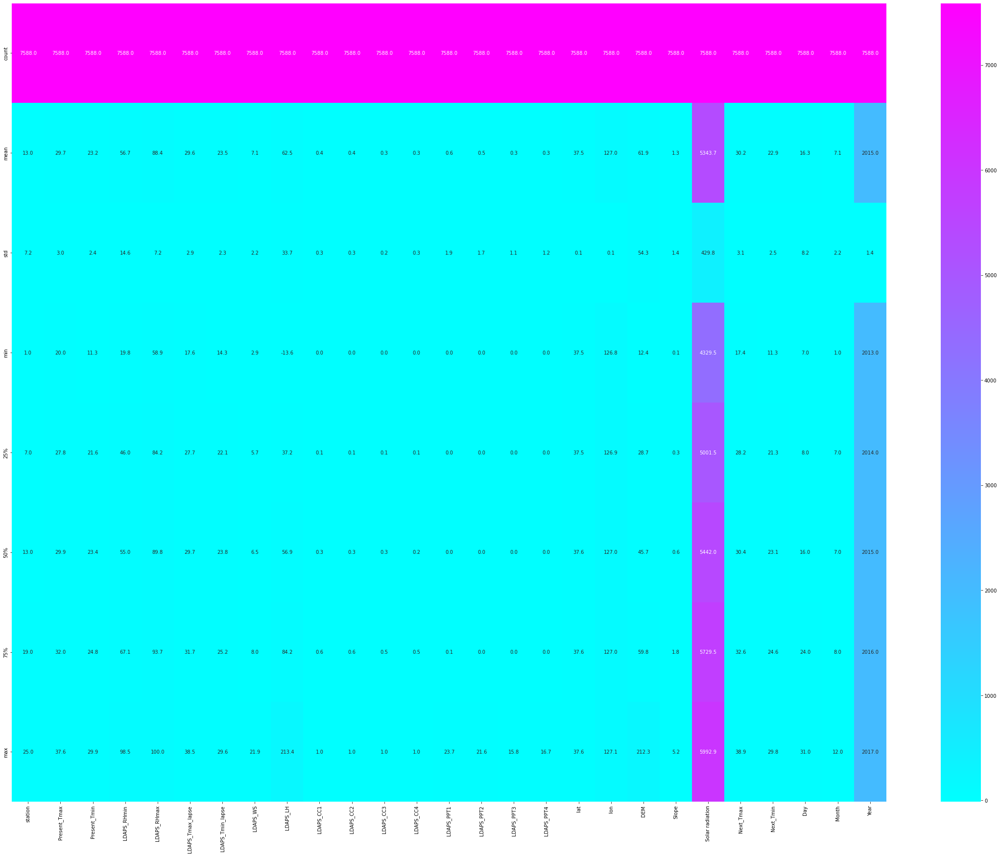

In [12]:
plt.figure(figsize=(40,30), facecolor='white')
sns.heatmap(df.describe(),fmt='0.1f',annot = True,cmap='cool')

# Data Visualisation


## univariant analysis

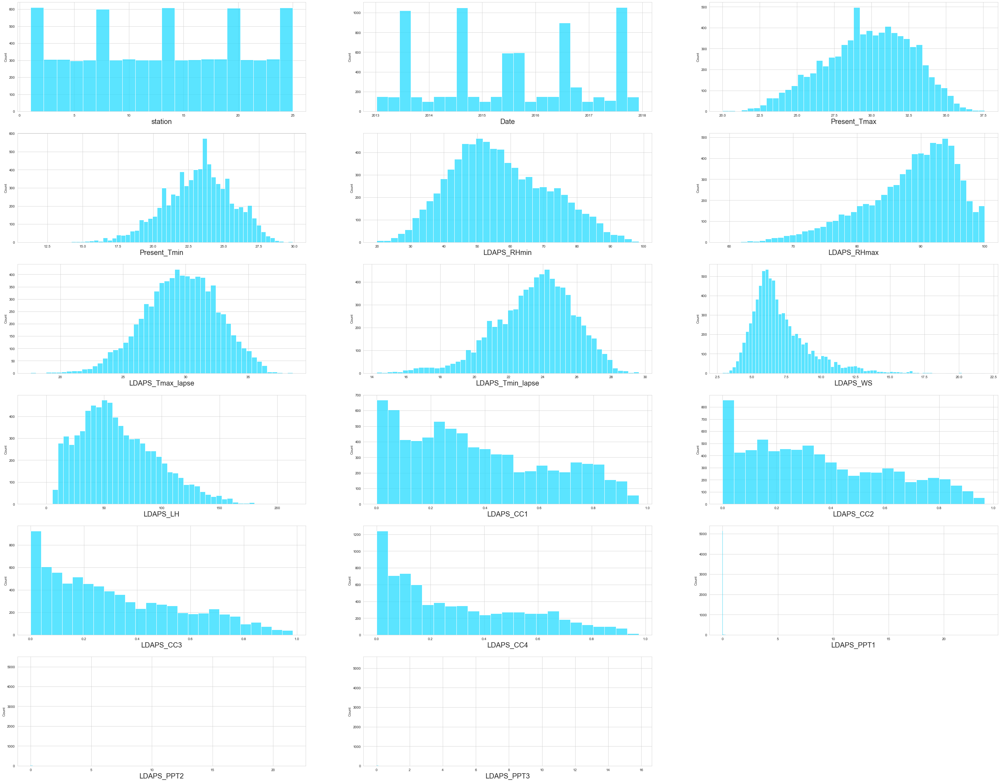

In [41]:
sns.set_palette('cool')
plt.figure(figsize=(50,40), facecolor='white')
plotnumber =1
for column in df:
    if plotnumber <=17:
        ax = plt.subplot(6,3,plotnumber)
        sns.histplot(df[column])
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.show()

## multivariant analysis

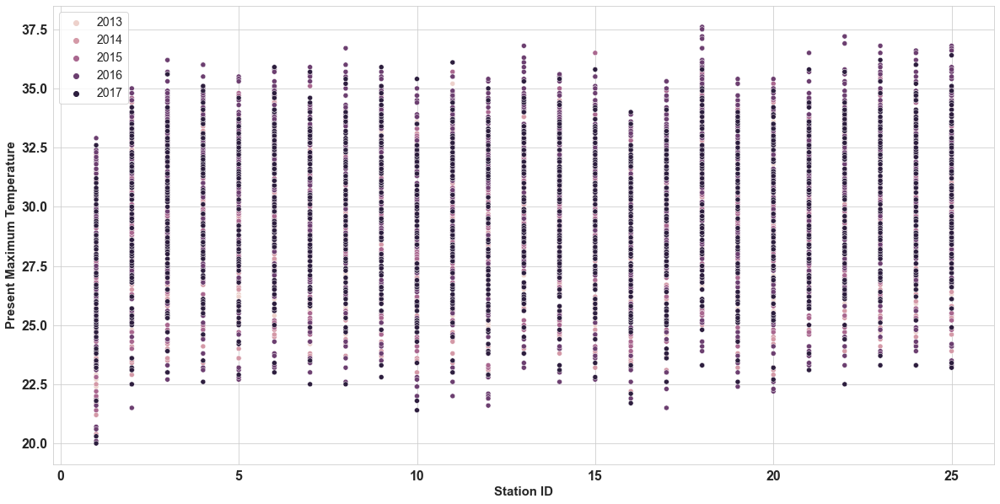

In [33]:
plt.figure(figsize=(20,10))
sns.set_style('whitegrid')
sns.scatterplot(x='station', y='Present_Tmax', data=df, hue='Year')
plt.xlabel('Station ID',{'fontsize':15,'fontweight' :'bold'})
plt.ylabel('Present Maximum Temperature',{'fontsize':15,'fontweight' :'bold'})
plt.xticks(fontsize=16,fontweight ='bold')
plt.yticks(fontsize=16,fontweight ='bold')
plt.legend(fontsize=14)

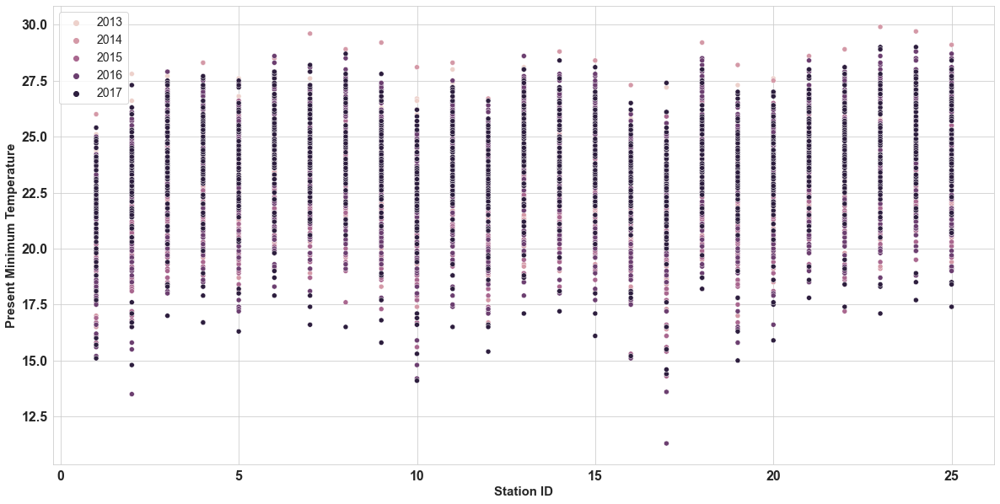

In [34]:
plt.figure(figsize=(20,10))
sns.set_style('whitegrid')
sns.scatterplot(x='station', y='Present_Tmin', data=df, hue='Year')
plt.xlabel('Station ID',{'fontsize':15,'fontweight' :'bold'})
plt.ylabel('Present Minimum Temperature',{'fontsize':15,'fontweight' :'bold'})
plt.xticks(fontsize=16,fontweight ='bold')
plt.yticks(fontsize=16,fontweight ='bold')
plt.legend(fontsize=14)


- Present Maximum Temperature Maxima over four year span recorded at station 18  with Temperature of 37.6 degree.
- Year 2014 is coolest year of all time frame.
- Highest Present Minimum Temperature recorded at Station 24  
- Station 1 is coolest station of all time followed by station 17. Must be tourist spot in Summer.

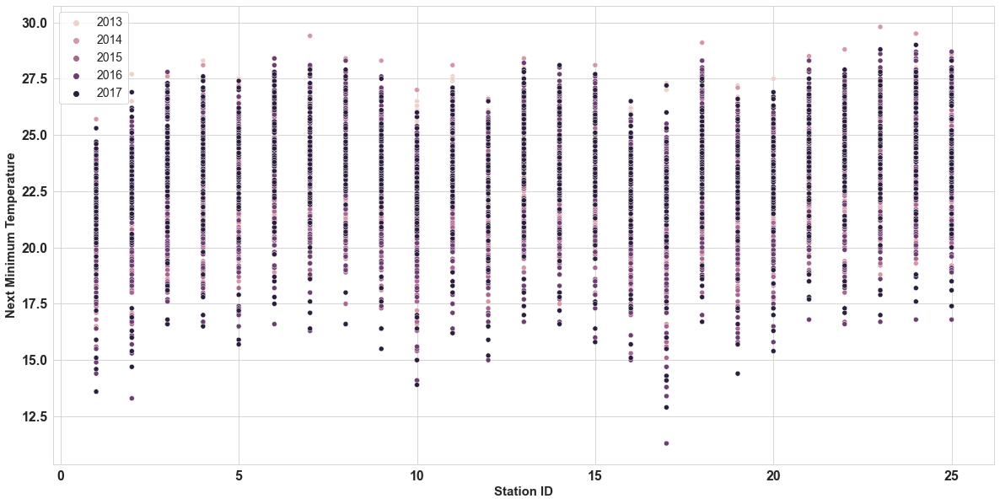

In [35]:
plt.figure(figsize=(20,10))
sns.set_style('whitegrid')
sns.scatterplot(x='station', y='Next_Tmin', data=df, hue='Year')
plt.xlabel('Station ID',{'fontsize':15,'fontweight' :'bold'})
plt.ylabel('Next Minimum Temperature',{'fontsize':15,'fontweight' :'bold'})
plt.xticks(fontsize=16,fontweight ='bold')
plt.yticks(fontsize=16,fontweight ='bold')
plt.legend(fontsize=14)

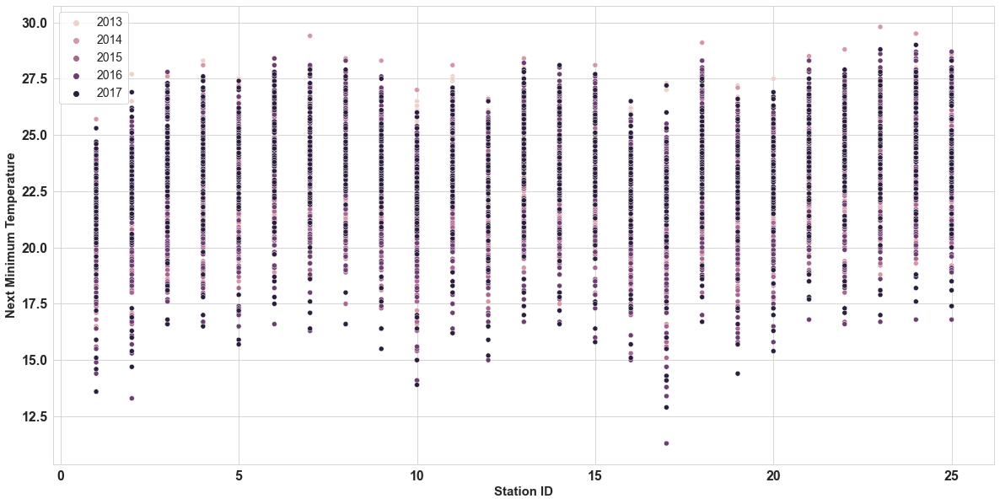

In [36]:
plt.figure(figsize=(20,10))
sns.set_style('whitegrid')
sns.scatterplot(x='station', y='Next_Tmin', data=df, hue='Year')
plt.xlabel('Station ID',{'fontsize':15,'fontweight' :'bold'})
plt.ylabel('Next Minimum Temperature',{'fontsize':15,'fontweight' :'bold'})
plt.xticks(fontsize=16,fontweight ='bold')
plt.yticks(fontsize=16,fontweight ='bold')
plt.legend(fontsize=14)

## bivariant analysis

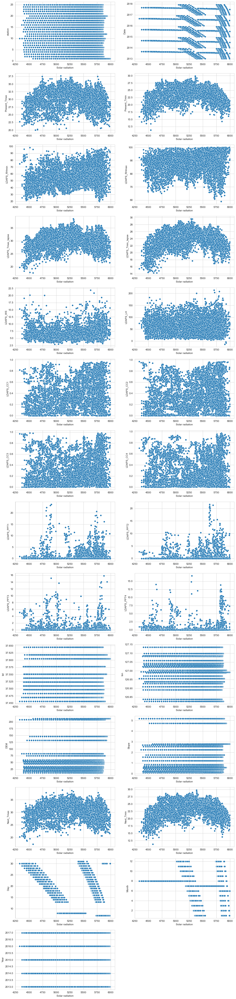

In [40]:
plt.figure(figsize=(15,200))
j = 0
for column, dtype in df.drop('Solar radiation',axis=1).dtypes.items():

    if dtype != 'object':
        j += 1
        plt.subplot(40,2,j)
        sns.scatterplot(df['Solar radiation'],df[column])

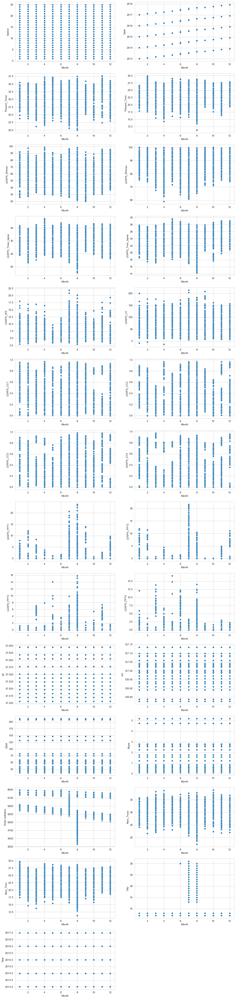

In [38]:
plt.figure(figsize=(15,200))
j = 0
for column, dtype in df.drop('Month',axis=1).dtypes.items():

    if dtype != 'object':
        j += 1
        plt.subplot(40,2,j)
        sns.scatterplot(df['Month'],df[column])


Solar Radiation data is  left skewed. 
It has its minimum value at 4329.52 Wh/m2 and maximum values at 5992.89 Wh/m2.
For most of reading solar radiation values lies in the range 5600 to 5850.
Minimum solar radiation occur in month of 8.
In 9th Month highest precipitation observe in 1st quarter of day.
In 1th Month highest precipitation observe in 2ed quarter of day.
In 11th Month highest precipitation observe in 3rd quarter of day.
In 6th Month highest precipitation observe in 4st quarter of day.
Minimum Latent Heat Flux observe in month of July.

In [43]:
# no revalant data
df.drop(['Date'], axis=1, inplace=True)

KeyError: "['Date'] not found in axis"

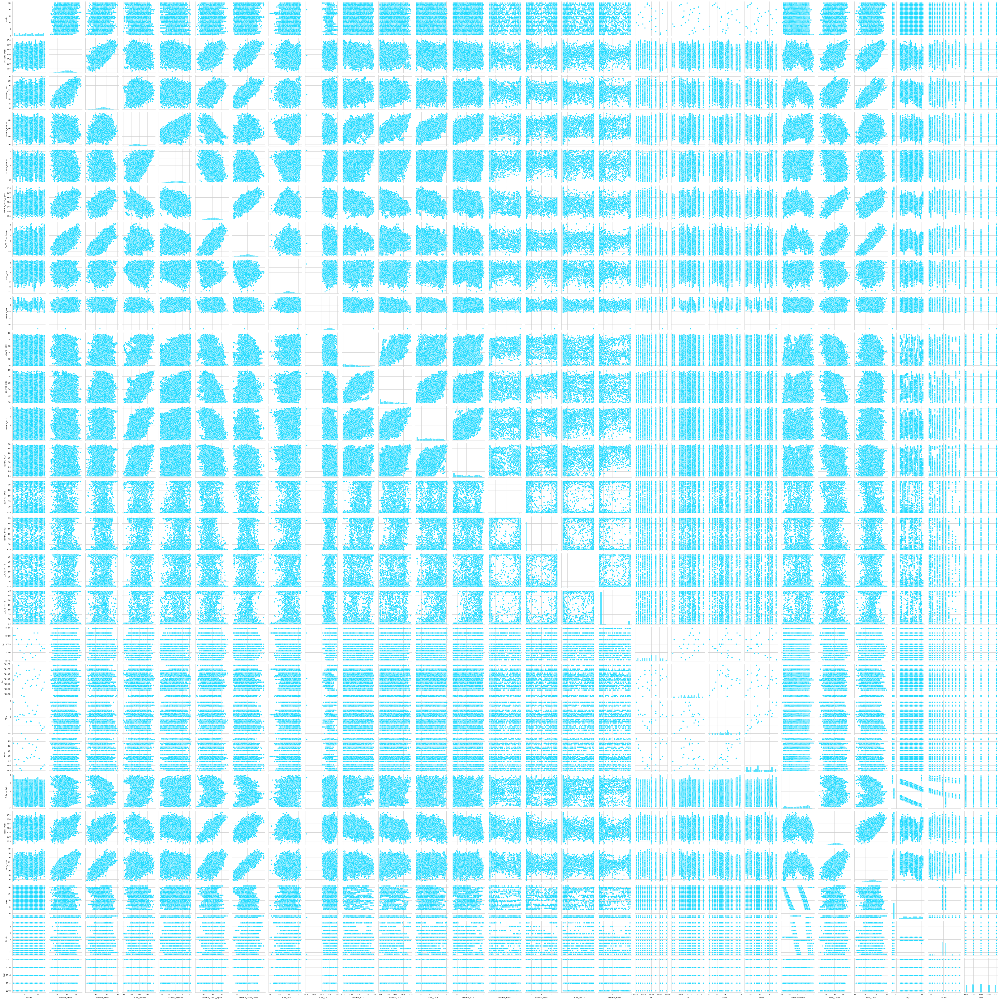

In [134]:
sns.pairplot(df)

# Feature selection and Engineering

## Detection and removal of outliners

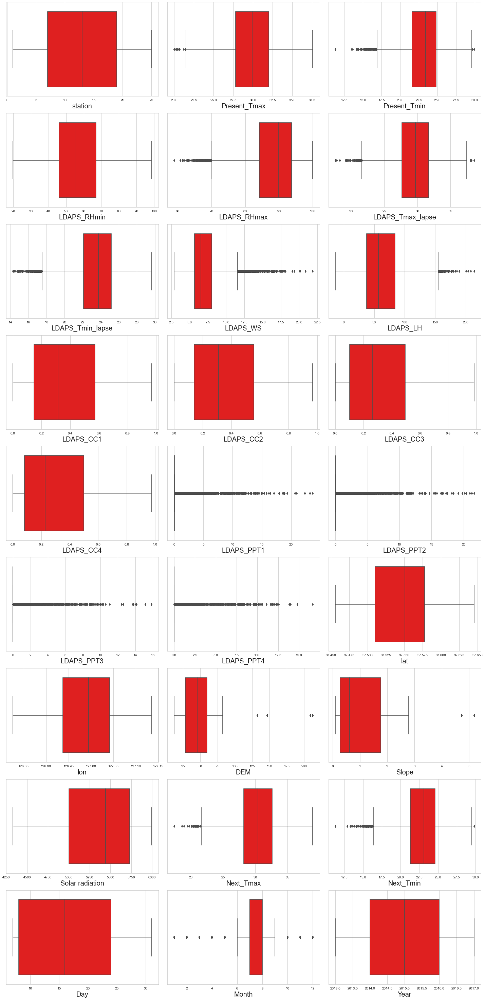

In [44]:
plt.figure(figsize=(20,45),facecolor='white')
plotnumber=1

for column in df:
    if plotnumber<=29:
        ax=plt.subplot(10,3,plotnumber)
        sns.boxplot(df[column],color='r')
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.tight_layout()
plt.show()

In [44]:
from scipy.stats import zscore
z = np.abs(zscore(df))
threshold = 3
df1 = df[(z<3).all(axis = 1)]

In [45]:
df=df1.copy()

## Detection and removal of  Skewness

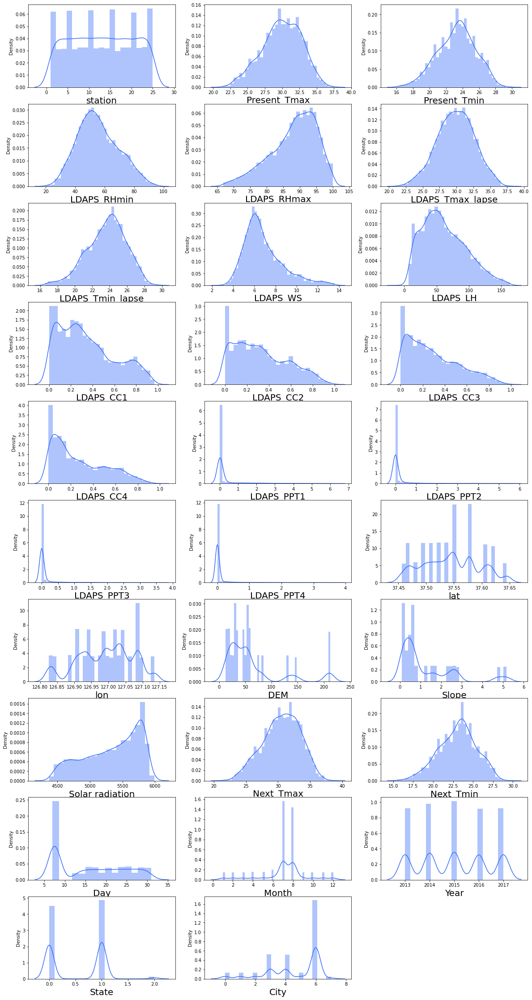

In [24]:
plt.figure(figsize=(20,40),facecolor='white')
sns.set_palette('rainbow')
plotnum=1
for col in df:
    if plotnum<=29:
        plt.subplot(10,3,plotnum)
        sns.distplot(df[col])
        plt.xlabel(col,fontsize=20)
    plotnum+=1
plt.show()

In [16]:
df.skew()

station            -0.001594
Present_Tmax       -0.269936
Present_Tmin       -0.221250
LDAPS_RHmin         0.309567
LDAPS_RHmax        -0.686083
LDAPS_Tmax_lapse   -0.110563
LDAPS_Tmin_lapse   -0.379269
LDAPS_WS            1.085685
LDAPS_LH            0.567050
LDAPS_CC1           0.594835
LDAPS_CC2           0.505774
LDAPS_CC3           0.701288
LDAPS_CC4           0.708754
LDAPS_PPT1          3.724580
LDAPS_PPT2          4.854967
LDAPS_PPT3          5.516862
LDAPS_PPT4          5.924324
lat                 0.106983
lon                -0.277547
DEM                 1.764698
Slope               1.590130
Solar radiation    -0.520157
Next_Tmax          -0.267526
Next_Tmin          -0.234328
Day                 0.256528
Month              -0.680725
Year                0.025066
dtype: float64

In [46]:
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method = 'yeo-johnson')

In [47]:
feau=['LDAPS_RHmax','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC3','LDAPS_CC4',
      'LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope','Solar radiation','Month']
df[feau] = scaler.fit_transform(df[feau].values)

In [48]:
df.skew()

station             0.001184
Present_Tmax       -0.273788
Present_Tmin       -0.208273
LDAPS_RHmin         0.311182
LDAPS_RHmax         0.001278
LDAPS_Tmax_lapse   -0.098463
LDAPS_Tmin_lapse    0.003332
LDAPS_WS           -0.028957
LDAPS_LH            0.003501
LDAPS_CC1           0.594803
LDAPS_CC2           0.508171
LDAPS_CC3           0.021080
LDAPS_CC4           0.033063
LDAPS_PPT1          1.162628
LDAPS_PPT2          1.326304
LDAPS_PPT3          1.393895
LDAPS_PPT4          1.663271
lat                 0.111778
lon                -0.277166
DEM                 0.011658
Slope               0.030658
Solar radiation    -0.040908
Next_Tmax          -0.257988
Next_Tmin          -0.205742
Day                 0.254152
Month               0.063521
Year                0.026770
dtype: float64

##  Detection and removal of Corrleation 

In [20]:
df.corr()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
station,1.000000,0.110291,0.133638,-0.069582,-0.182354,0.066863,0.108664,0.030231,-0.135717,0.008671,...,-0.241811,-0.122829,-0.326019,-0.146034,-0.034787,0.106378,0.129110,0.005179,0.003494,0.006658
Present_Tmax,0.110291,1.000000,0.610428,-0.154266,-0.320074,0.540680,0.623443,-0.071596,0.119022,-0.290078,...,-0.052041,0.011132,-0.130892,-0.092409,-0.099696,0.586943,0.615950,-0.136914,0.039443,0.099185
Present_Tmin,0.133638,0.610428,1.000000,0.151385,-0.053421,0.441577,0.764041,0.034364,-0.008556,0.090828,...,-0.072707,-0.043201,-0.238916,-0.157839,-0.047145,0.438813,0.785946,-0.076877,-0.019387,0.099222
LDAPS_RHmin,-0.069582,-0.154266,0.151385,1.000000,0.566069,-0.555583,0.114069,0.171684,-0.002412,0.574389,...,0.090054,-0.093969,0.057460,0.083910,0.229070,-0.433872,0.134518,-0.070194,-0.070498,0.001709
LDAPS_RHmax,-0.182354,-0.320074,-0.053421,0.566069,1.000000,-0.403634,-0.182113,0.060965,0.285942,0.425827,...,0.232258,0.013059,0.174176,0.209222,0.154031,-0.323446,-0.110402,-0.009056,-0.049410,-0.146019
LDAPS_Tmax_lapse,0.066863,0.540680,0.441577,-0.555583,-0.403634,1.000000,0.624572,-0.154400,0.005878,-0.416255,...,-0.038285,0.106354,-0.110286,-0.105094,-0.034699,0.816861,0.553227,-0.140514,-0.014191,0.066794
LDAPS_Tmin_lapse,0.108664,0.623443,0.764041,0.114069,-0.182113,0.624572,1.000000,-0.002164,-0.143246,0.023128,...,-0.091796,-0.025047,-0.174769,-0.160165,0.009890,0.550810,0.873678,-0.141718,-0.018686,0.061339
LDAPS_WS,0.030231,-0.071596,0.034364,0.171684,0.060965,-0.154400,-0.002164,1.000000,-0.056362,0.203057,...,-0.027463,-0.077686,0.113157,0.095385,0.164626,-0.205979,0.023330,-0.050895,-0.065461,-0.119526
LDAPS_LH,-0.135717,0.119022,-0.008556,-0.002412,0.285942,0.005878,-0.143246,-0.056362,1.000000,-0.113430,...,0.100486,0.009790,0.053275,0.069892,-0.032027,0.151784,-0.052365,-0.014488,-0.017527,0.054981
LDAPS_CC1,0.008671,-0.290078,0.090828,0.574389,0.425827,-0.416255,0.023128,0.203057,-0.113430,1.000000,...,-0.006352,-0.013794,-0.030080,-0.032476,0.235623,-0.453763,0.008400,-0.034100,-0.106406,-0.069276


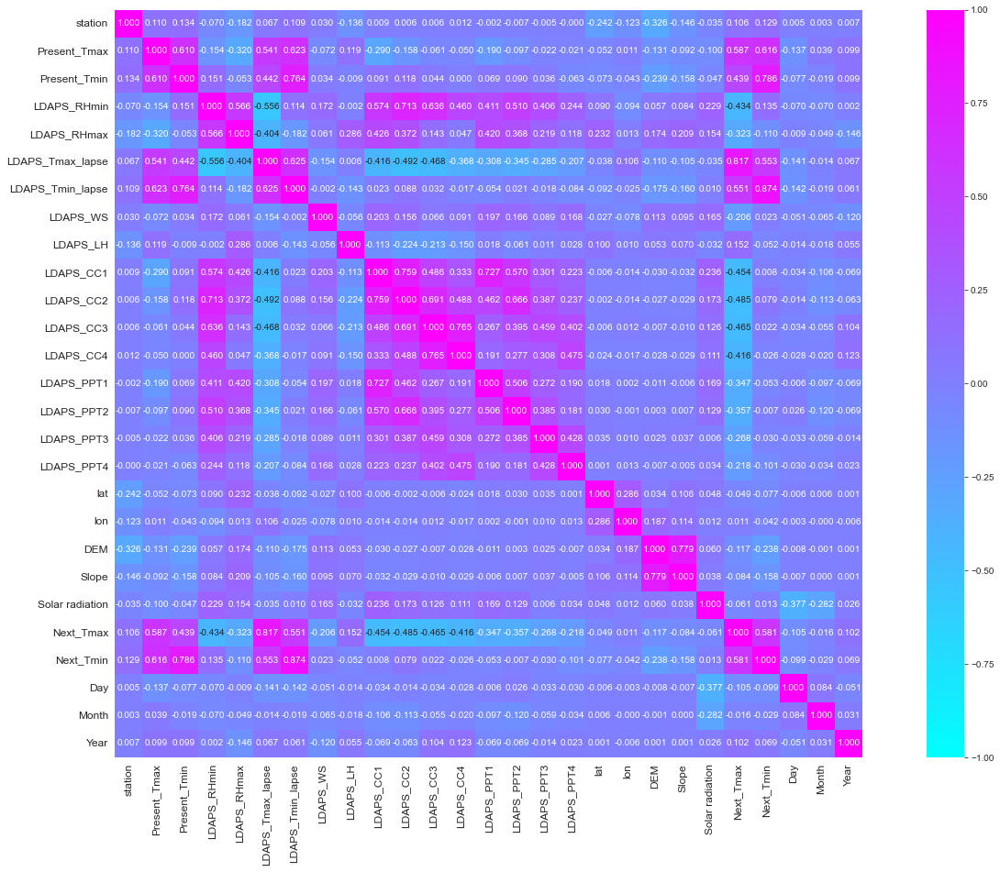

In [52]:
plt.figure(figsize=(25,15))
sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, square=True, fmt='0.3f', 
            annot_kws={'size':10}, cmap="cool")
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

## Detection and removal of multicollinearity

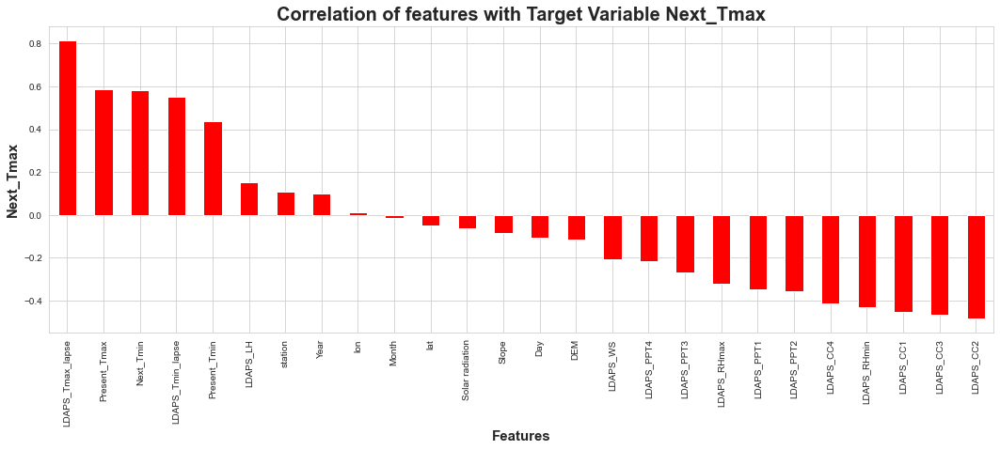

In [54]:
plt.figure(figsize = (18,6))
df.corr()['Next_Tmax'].drop(['Next_Tmax']).sort_values(ascending=False).plot(kind='bar',color = 'r')
plt.xlabel('Features',fontsize=15,fontweight='bold')
plt.ylabel('Next_Tmax',fontsize=15,fontweight='bold')
plt.title('Correlation of features with Target Variable Next_Tmax',fontsize = 20,fontweight='bold')
plt.show()

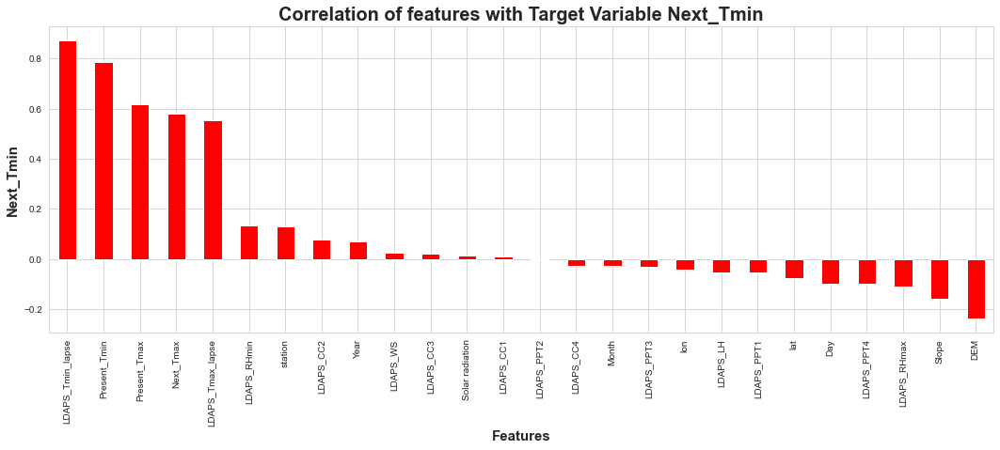

In [53]:
plt.figure(figsize = (18,6))
df.corr()['Next_Tmin'].drop(['Next_Tmin']).sort_values(ascending=False).plot(kind='bar',color = 'r')
plt.xlabel('Features',fontsize=15,fontweight='bold')
plt.ylabel('Next_Tmin',fontsize=15,fontweight='bold')
plt.title('Correlation of features with Target Variable Next_Tmin',fontsize = 20,fontweight='bold')
plt.show()

In [49]:
df1=df.copy()
df2=df.copy()

# Machine Learning Model Building For Next_Tmax

## Standard Scaling

In [50]:
# Splitting data in target and dependent feature
X = df1.drop(['Next_Tmax'], axis =1)
Y = df1['Next_Tmax']

In [51]:
from sklearn.preprocessing import StandardScaler
scaler= StandardScaler()
X_scale = scaler.fit_transform(X)

## Checking Multicollinearity 

In [24]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X_scale,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,1.290528,station
1,2.848829,Present_Tmax
2,3.382429,Present_Tmin
3,6.037396,LDAPS_RHmin
4,2.611983,LDAPS_RHmax
5,6.621815,LDAPS_Tmax_lapse
6,8.203124,LDAPS_Tmin_lapse
7,1.223949,LDAPS_WS
8,1.520712,LDAPS_LH
9,4.873088,LDAPS_CC1


## PCA

In [52]:
from sklearn.decomposition import PCA
pca = PCA()
x_pca = pca.fit_transform(X_scale)


In [53]:
pca_new = PCA(n_components=10)
x_new = pca_new.fit_transform(X_scale)

In [54]:
principle_x=pd.DataFrame(x_new,columns=np.arange(10))

# Regression model

In [68]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import  GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import  Ridge
from sklearn.linear_model import  Lasso

In [56]:
X_train, X_test, Y_train, Y_test = train_test_split(principle_x, Y, random_state=42, test_size=.33)


### Finding best Random state

In [21]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
maxR2_score=0
maxRS=0
for i in range(1,500):
    X_train, X_test, Y_train, Y_test = train_test_split(X_scale, Y, random_state=i, test_size=.33)
    lin_reg=LinearRegression()
    lin_reg.fit(X_train,Y_train)
    y_pred=lin_reg.predict(X_test)
    R2=r2_score(Y_test,y_pred)
    if R2>maxR2_score:
        maxR2_score=R2
        maxRS=i
print('Best R2 Score is', maxR2_score ,'on Random_state', maxRS)

Best R2 Score is 0.8017871901295115 on Random_state 108


In [57]:
from sklearn.model_selection import cross_val_score

In [25]:
lr=LinearRegression()
rf = RandomForestRegressor()
dtc = DecisionTreeRegressor()
XT = ExtraTreesRegressor()
BR = BaggingRegressor()
adb=AdaBoostRegressor()
gradb=GradientBoostingRegressor()
model = [lr,rf,XT,dtc,adb,gradb]

for m in model:
    m.fit(X_train,Y_train)
    m.score(X_train,Y_train)
    y_pred = m.predict(X_test)

    print('\033[1m'+' R2 Score :'+'\033[0m')
    print(r2_score(Y_test,y_pred)) 
    print('==============================================================================================================')

 R2 Score :
0.7986262665945841
 R2 Score :
0.9073364564864012
 R2 Score :
0.9303109675594371
 R2 Score :
0.7528443859181182
 R2 Score :
0.7707558002544738
 R2 Score :
0.866573985819917


In [71]:
# Cross Validation
model = [lr,rf,XT,dtc,adb,gradb]

for m in model:
    score = cross_val_score(m, X_scale, Y, cv =5)
    print('\n')
    print('\033[1m'+'Cross Validation Score :',m,":"+'\033[0m\n')
    print("Mean CV Score :",score.mean())
    print('==============================================================================================================')



Cross Validation Score : LinearRegression() :

Mean CV Score : 0.675801953410897


Cross Validation Score : RandomForestRegressor(max_depth=25, n_estimators=70) :

Mean CV Score : 0.6861200602750065


Cross Validation Score : ExtraTreesRegressor() :

Mean CV Score : 0.6920130667090436


Cross Validation Score : DecisionTreeRegressor() :

Mean CV Score : 0.4130004663628508


Cross Validation Score : AdaBoostRegressor(learning_rate=0.1) :

Mean CV Score : 0.6447968334509264


Cross Validation Score : GradientBoostingRegressor(max_depth=25) :

Mean CV Score : 0.4690369428906056


# Hyper Parameter Tuning 

In [59]:
from sklearn.model_selection import GridSearchCV

In [60]:
parameter = {'n_estimators':[70],'max_depth': [25],
            'criterion':['mse','mae'],'min_samples_leaf': [5,10],
             'min_samples_split':[5,10],
             'max_features':["auto","sqrt"]}

In [61]:
GCV = GridSearchCV(rf,parameter,cv=3,n_jobs = -1,verbose=3)

In [62]:
GCV.fit(X_train,Y_train)

Fitting 3 folds for each of 16 candidates, totalling 48 fits


GridSearchCV(cv=3,
             estimator=RandomForestRegressor(max_depth=25, n_estimators=70),
             n_jobs=-1,
             param_grid={'criterion': ['mse', 'mae'], 'max_depth': [25],
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [5, 10],
                         'min_samples_split': [5, 10], 'n_estimators': [70]},
             verbose=3)

In [63]:
GCV.best_params_

{'criterion': 'mse',
 'max_depth': 25,
 'max_features': 'auto',
 'min_samples_leaf': 5,
 'min_samples_split': 5,
 'n_estimators': 70}

## Final Regression Model

In [69]:
Final = RandomForestRegressor(criterion='mse',max_depth= 25,max_features= 'auto',min_samples_leaf= 5,min_samples_split= 5,n_estimators= 70)
Final.fit(X_train,Y_train)
y_pred=Final.predict(X_test)
print('rmse:', np.sqrt(mean_squared_error(Y_test,y_pred)))
print('\n')
print('accuracy')
print(r2_score(Y_test,y_pred)) 
print('\n')

rmse: 1.4116807032650542


accuracy
0.762226189185534




 True Values Vs Predicted Value plot :


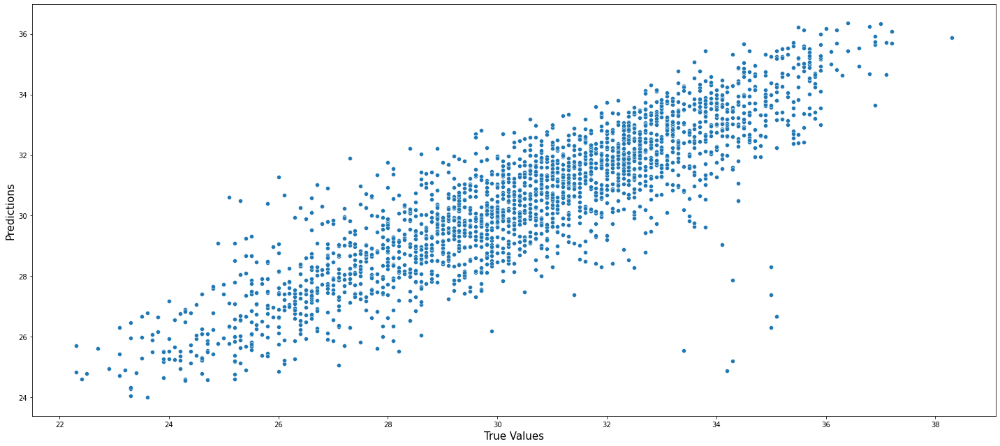

In [70]:
plt.figure(figsize=(20,9))
y_pred=Final.predict(X_test)
sns.scatterplot(Y_test.round(2), y_pred)
print(' True Values Vs Predicted Value plot :')
plt.xlabel('True Values' , fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.tight_layout()

## Final Regression Saving Model

In [137]:
import joblib
joblib.dump(Final,'Next_Tmax_Forecast.pkl')

['Next_Tmax_Forecast.pkl']

# Machine Learning Model Building For Next_Tmin

## Standard Scaling

In [72]:
# Splitting data in target and dependent feature
X = df2.drop(['Next_Tmin'], axis =1)
Y = df2['Next_Tmin']

In [73]:
from sklearn.preprocessing import StandardScaler
scaler= StandardScaler()
X_scale = scaler.fit_transform(X)

In [86]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import  GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import  Ridge
from sklearn.linear_model import  Lasso

In [83]:
X_train, X_test, Y_train, Y_test = train_test_split(X_scale, Y, random_state=42, test_size=.33)

### Finding best Random state

In [75]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
maxR2_score=0
maxRS=0
for i in range(1,500):
    X_train, X_test, Y_train, Y_test = train_test_split(X_scale, Y, random_state=i, test_size=.33)
    lin_reg=LinearRegression()
    lin_reg.fit(X_train,Y_train)
    y_pred=lin_reg.predict(X_test)
    R2=r2_score(Y_test,y_pred)
    if R2>maxR2_score:
        maxR2_score=R2
        maxRS=i
print('Best R2 Score is', maxR2_score ,'on Random_state', maxRS)

Best R2 Score is 0.850904360569565 on Random_state 267


In [76]:
lr=LinearRegression()
rf = RandomForestRegressor()
dtc = DecisionTreeRegressor()
XT = ExtraTreesRegressor()
BR = BaggingRegressor()
adb=AdaBoostRegressor()
gradb=GradientBoostingRegressor()
model = [lr,rf,XT,dtc,adb,gradb]

for m in model:
    m.fit(X_train,Y_train)
    m.score(X_train,Y_train)
    y_pred = m.predict(X_test)

    print('\033[1m'+' R2 Score :'+'\033[0m')
    print(r2_score(Y_test,y_pred)) 
    print('==============================================================================================================')

 R2 Score :
0.8374833894350882
 R2 Score :
0.9014412333636166
 R2 Score :
0.912673048675874
 R2 Score :
0.7842800194243424
 R2 Score :
0.8131354683705083
 R2 Score :
0.8902711573611897


In [77]:
# Cross Validation
model = [lr,rf,XT,dtc,adb,gradb]

for m in model:
    score = cross_val_score(m, X_scale, Y, cv =5)
    print('\n')
    print("Mean CV Score :",score.mean())
    print('==============================================================================================================')



Mean CV Score : 0.7877341618239223


Mean CV Score : 0.7894597105006153


Mean CV Score : 0.7907984014431323


Mean CV Score : 0.606755150249333


Mean CV Score : 0.7411251569615829


Mean CV Score : 0.8019678642858633


# Hyper Parameter Tuning 

In [78]:
from sklearn.model_selection import GridSearchCV

In [98]:
parameter = {'max_depth': [5,10,],
            'criterion':['mse','mae'],'max_features':["auto","sqrt"]}

In [99]:
GCV = GridSearchCV(dtc,parameter,verbose =10)


In [100]:
GCV.fit(X_train,Y_train)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
[CV 1/5; 1/8] START criterion=mse, max_depth=5, max_features=auto...............
[CV 1/5; 1/8] END criterion=mse, max_depth=5, max_features=auto;, score=0.780 total time=   0.3s
[CV 2/5; 1/8] START criterion=mse, max_depth=5, max_features=auto...............
[CV 2/5; 1/8] END criterion=mse, max_depth=5, max_features=auto;, score=0.788 total time=   0.1s
[CV 3/5; 1/8] START criterion=mse, max_depth=5, max_features=auto...............
[CV 3/5; 1/8] END criterion=mse, max_depth=5, max_features=auto;, score=0.799 total time=   0.0s
[CV 4/5; 1/8] START criterion=mse, max_depth=5, max_features=auto...............
[CV 4/5; 1/8] END criterion=mse, max_depth=5, max_features=auto;, score=0.806 total time=   0.0s
[CV 5/5; 1/8] START criterion=mse, max_depth=5, max_features=auto...............
[CV 5/5; 1/8] END criterion=mse, max_depth=5, max_features=auto;, score=0.795 total time=   0.1s
[CV 1/5; 2/8] START criterion=mse, max_depth=5, ma

GridSearchCV(estimator=DecisionTreeRegressor(),
             param_grid={'criterion': ['mse', 'mae'], 'max_depth': [5, 10],
                         'max_features': ['auto', 'sqrt']},
             verbose=10)

In [101]:
GCV.best_params_

{'criterion': 'mse', 'max_depth': 5, 'max_features': 'auto'}

## Final Regression Model For Next_Tmin

In [96]:
Final = DecisionTreeRegressor(criterion='mse',max_depth=5 ,max_features='auto')
Y=Y.astype('int')
Final.fit(X_train,Y_train)

y_pred=Final.predict(X_test)
print('\n')                                        
print(r2_score(Y_test,y_pred)) 
print('\n')



0.7868218129415888




 True Values Vs Predicted Value plot :


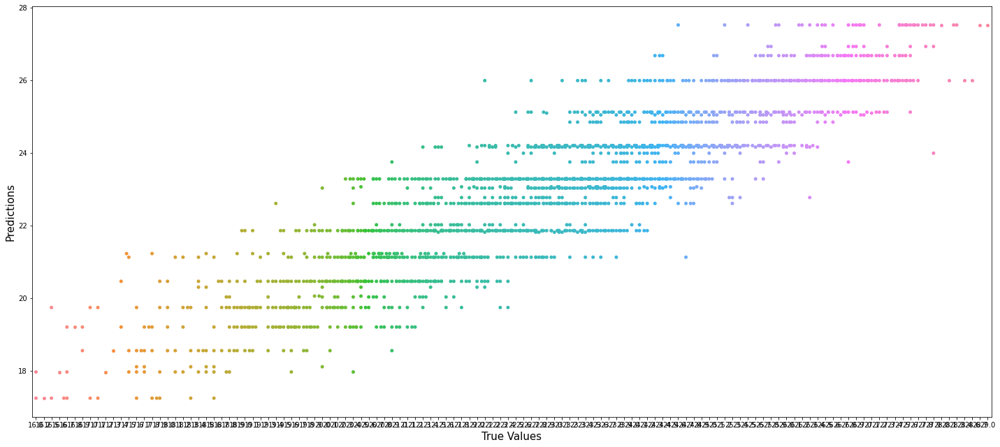

In [105]:
plt.figure(figsize=(20,9))
y_pred=Final.predict(X_test)
sns.swarmplot(Y_test.round(2), y_pred)
print(' True Values Vs Predicted Value plot :')
plt.xlabel('True Values' , fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.tight_layout()

## Saving  Final Regression Model For Next_Tmin

In [103]:
import joblib
joblib.dump(Final,'Next_Tmin_Forecast.pkl')

['Next_Tmin_Forecast.pkl']